In [16]:
import osmnx as ox

In [17]:
adress = "Rotterdam, Netherlands"
distance = 2000
graph = ox.graph_from_address(adress, network_type='walk', dist=distance)

In [18]:
nodes, edges = ox.graph_to_gdfs(graph)



In [19]:
import leafmap

m = leafmap.Map(center=[51.9225, 4.47917], zoom=12)
m.add_gdf(edges, layer_name="Edges", color="red", line_weight=2)
m

Map(center=[51.9225, 4.47917], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zo…

In [20]:
green_area = ox.features_from_address(tags={"leisure":"park","landuse":"grass"},address=adress, dist=distance)

# landuse	grass

In [22]:
m = leafmap.Map(center=[51.9225, 4.47917], zoom=12)
m.add_gdf(edges, layer_name="Edges", color="red", line_weight=2)
m.add_gdf(green_area, layer_name="Green Areas", color="green", fill_opacity=0.5)
m

Map(center=[51.9225, 4.47917], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zo…

In [23]:
# Find edges that intersect with green areas
import geopandas as gpd
from shapely.geometry import LineString

# Ensure both GDFs have the same CRS
edges_projected = edges.to_crs('EPSG:3857')  # Web Mercator for accurate intersections
green_area_projected = green_area.to_crs('EPSG:3857')

# Find intersecting edges
intersecting_edges = gpd.sjoin(edges_projected, green_area_projected, how='inner', predicate='intersects')
intersecting_edge_ids = intersecting_edges.index.unique()

print(f"Total edges: {len(edges)}")
print(f"Edges intersecting green areas: {len(intersecting_edge_ids)}")
print(f"Percentage of edges intersecting green areas: {len(intersecting_edge_ids)/len(edges)*100:.2f}%")

Total edges: 19888
Edges intersecting green areas: 1592
Percentage of edges intersecting green areas: 8.00%


In [30]:
# Create filtered network without green-intersecting edges
import networkx as nx

# Create a copy of the original graph
filtered_graph = graph.copy()

# Remove edges that intersect with green areas
edges_to_remove = []
for u, v, k in graph.edges(keys=True):
    # Check if this edge is in our intersecting edges list
    edge_id = (u, v, k)
    if edge_id in intersecting_edge_ids:
        edges_to_remove.append((u, v, k))

# Remove the intersecting edges
filtered_graph.remove_edges_from(edges_to_remove)

print(f"Original graph edges: {len(graph.edges())}")
print(f"Filtered graph edges: {len(filtered_graph.edges())}")
print(f"Edges removed: {len(edges_to_remove)}")

# Convert filtered graph to GeoDataFrames
filtered_nodes, filtered_edges = ox.graph_to_gdfs(filtered_graph)

Original graph edges: 19888
Filtered graph edges: 18296
Edges removed: 1592


In [31]:
# Calculate centrality measures for original network
print("Calculating centrality measures for original network...")

# Convert to undirected for centrality calculations
graph_undirected = ox.convert.to_undirected(graph)

# Calculate different centrality measures
original_betweenness = nx.betweenness_centrality(graph_undirected, k=1000, seed=42)  # Sample for speed
original_closeness = nx.closeness_centrality(graph_undirected)
original_degree = nx.degree_centrality(graph_undirected)
# original_eigenvector = nx.eigenvector_centrality(graph_undirected, max_iter=1000)

print("Original network centrality measures calculated.")

Calculating centrality measures for original network...
Original network centrality measures calculated.


In [32]:
# Calculate centrality measures for filtered network
print("Calculating centrality measures for filtered network...")

# Convert to undirected for centrality calculations
filtered_graph_undirected = ox.convert.to_undirected(filtered_graph)

# Calculate different centrality measures
filtered_betweenness = nx.betweenness_centrality(filtered_graph_undirected, k=1000, seed=42)
filtered_closeness = nx.closeness_centrality(filtered_graph_undirected)
filtered_degree = nx.degree_centrality(filtered_graph_undirected)
# filtered_eigenvector = nx.eigenvector_centrality(filtered_graph_undirected, max_iter=1000)

print("Filtered network centrality measures calculated.")

Calculating centrality measures for filtered network...
Filtered network centrality measures calculated.


In [33]:
# Compare centrality measures between networks
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Find common nodes between both networks
common_nodes = set(original_betweenness.keys()) & set(filtered_betweenness.keys())
print(f"Common nodes for comparison: {len(common_nodes)}")

# Create comparison dataframes
comparison_data = []
for node in common_nodes:
    comparison_data.append({
        'node': node,
        'orig_betweenness': original_betweenness.get(node, 0),
        'filt_betweenness': filtered_betweenness.get(node, 0),
        'orig_closeness': original_closeness.get(node, 0),
        'filt_closeness': filtered_closeness.get(node, 0),
        'orig_degree': original_degree.get(node, 0),
        'filt_degree': filtered_degree.get(node, 0),
        # 'orig_eigenvector': original_eigenvector.get(node, 0),
        # 'filt_eigenvector': filtered_eigenvector.get(node, 0)
    })

df_comparison = pd.DataFrame(comparison_data)

# Calculate differences
df_comparison['betweenness_diff'] = df_comparison['filt_betweenness'] - df_comparison['orig_betweenness']
df_comparison['closeness_diff'] = df_comparison['filt_closeness'] - df_comparison['orig_closeness']
df_comparison['degree_diff'] = df_comparison['filt_degree'] - df_comparison['orig_degree']
# df_comparison['eigenvector_diff'] = df_comparison['filt_eigenvector'] - df_comparison['orig_eigenvector']

print("Centrality comparison summary:")
print(f"Mean betweenness change: {df_comparison['betweenness_diff'].mean():.6f}")
print(f"Mean closeness change: {df_comparison['closeness_diff'].mean():.6f}")
print(f"Mean degree change: {df_comparison['degree_diff'].mean():.6f}")
# print(f"Mean eigenvector change: {df_comparison['eigenvector_diff'].mean():.6f}")

print("\\nStandard deviations:")
print(f"Betweenness std: {df_comparison['betweenness_diff'].std():.6f}")
print(f"Closeness std: {df_comparison['closeness_diff'].std():.6f}")
print(f"Degree std: {df_comparison['degree_diff'].std():.6f}")
# print(f"Eigenvector std: {df_comparison['eigenvector_diff'].std():.6f}")

Common nodes for comparison: 6963
Centrality comparison summary:
Mean betweenness change: -0.000736
Mean closeness change: -0.003795
Mean degree change: -0.000033
\nStandard deviations:
Betweenness std: 0.004746
Closeness std: 0.005623
Degree std: 0.000106


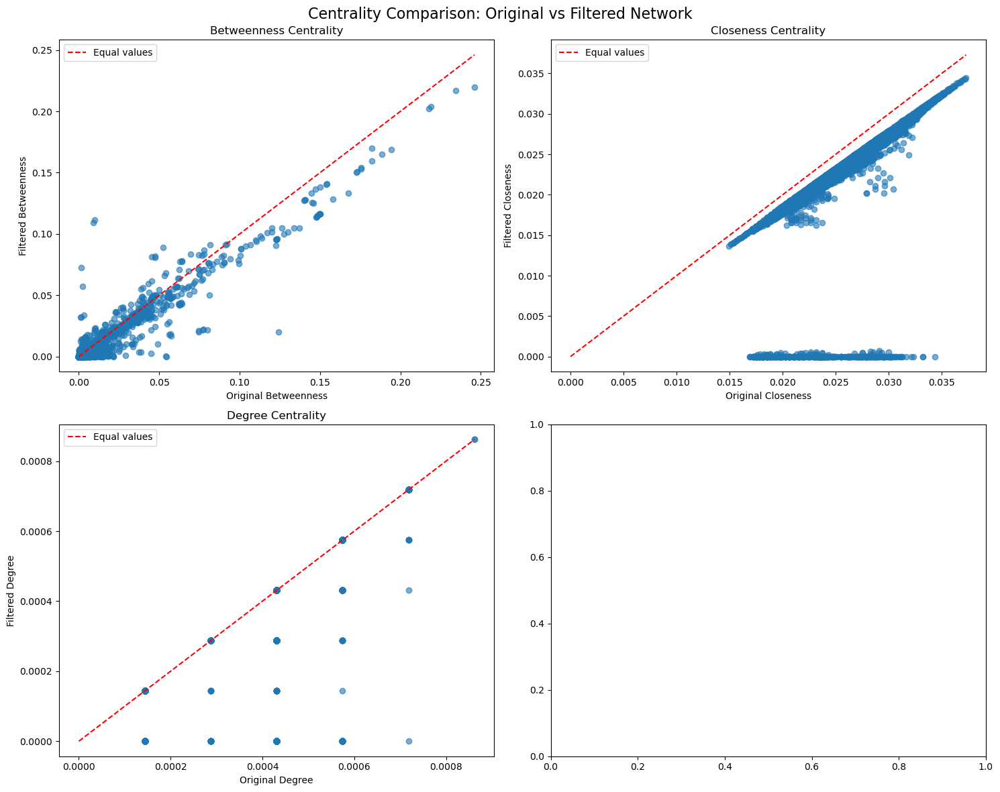

In [34]:
# Create visualizations comparing the networks
fig, axes = plt.subplots(2, 2, figsize=(15, 12))
fig.suptitle('Centrality Comparison: Original vs Filtered Network', fontsize=16)

# Betweenness centrality scatter plot
axes[0,0].scatter(df_comparison['orig_betweenness'], df_comparison['filt_betweenness'], alpha=0.6)
axes[0,0].plot([0, df_comparison['orig_betweenness'].max()], [0, df_comparison['orig_betweenness'].max()], 'r--', label='Equal values')
axes[0,0].set_xlabel('Original Betweenness')
axes[0,0].set_ylabel('Filtered Betweenness')
axes[0,0].set_title('Betweenness Centrality')
axes[0,0].legend()

# Closeness centrality scatter plot
axes[0,1].scatter(df_comparison['orig_closeness'], df_comparison['filt_closeness'], alpha=0.6)
axes[0,1].plot([0, df_comparison['orig_closeness'].max()], [0, df_comparison['orig_closeness'].max()], 'r--', label='Equal values')
axes[0,1].set_xlabel('Original Closeness')
axes[0,1].set_ylabel('Filtered Closeness')
axes[0,1].set_title('Closeness Centrality')
axes[0,1].legend()

# Degree centrality scatter plot
axes[1,0].scatter(df_comparison['orig_degree'], df_comparison['filt_degree'], alpha=0.6)
axes[1,0].plot([0, df_comparison['orig_degree'].max()], [0, df_comparison['orig_degree'].max()], 'r--', label='Equal values')
axes[1,0].set_xlabel('Original Degree')
axes[1,0].set_ylabel('Filtered Degree')
axes[1,0].set_title('Degree Centrality')
axes[1,0].legend()

# Eigenvector centrality scatter plot
# axes[1,1].scatter(df_comparison['orig_eigenvector'], df_comparison['filt_eigenvector'], alpha=0.6)
# axes[1,1].plot([0, df_comparison['orig_eigenvector'].max()], [0, df_comparison['orig_eigenvector'].max()], 'r--', label='Equal values')
# axes[1,1].set_xlabel('Original Eigenvector')
# axes[1,1].set_ylabel('Filtered Eigenvector')
# axes[1,1].set_title('Eigenvector Centrality')
# axes[1,1].legend()

plt.tight_layout()
plt.show()

In [35]:
# Create a clearer visual comparison of the networks
import matplotlib.pyplot as plt

# Create a map showing removed edges and centrality differences
m_comparison = leafmap.Map(center=[51.9225, 4.47917], zoom=12)

# Add the filtered network edges (remaining edges) in blue
m_comparison.add_gdf(filtered_edges, layer_name="Remaining Edges", color="blue", line_weight=2)

# Create a GeoDataFrame for removed edges
removed_edges_gdf = edges.loc[intersecting_edge_ids].copy()
m_comparison.add_gdf(removed_edges_gdf, layer_name="Removed Edges (through green spaces)", color="red", line_weight=3)

# Add green areas with transparency
m_comparison.add_gdf(green_area, layer_name="Green Areas", color="green", fill_opacity=0.3)

print(f"Red edges: {len(removed_edges_gdf)} streets removed (passed through green spaces)")
print(f"Blue edges: {len(filtered_edges)} streets remaining")
print(f"Green areas: Parks and green spaces")

m_comparison

Red edges: 1592 streets removed (passed through green spaces)
Blue edges: 18296 streets remaining
Green areas: Parks and green spaces


Map(center=[51.9225, 4.47917], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zo…

In [36]:
# Create a map showing nodes with highest centrality changes
# Find nodes with biggest centrality differences
top_betweenness_changes = df_comparison.nlargest(50, 'betweenness_diff')
top_closeness_changes = df_comparison.nlargest(50, 'closeness_diff')

# Get node coordinates for visualization
node_coords = []
for node_id in top_betweenness_changes['node']:
    node_data = nodes.loc[node_id]
    node_coords.append({
        'node_id': node_id,
        'lat': node_data.geometry.y,
        'lon': node_data.geometry.x,
        'betweenness_change': df_comparison[df_comparison['node'] == node_id]['betweenness_diff'].iloc[0],
        'closeness_change': df_comparison[df_comparison['node'] == node_id]['closeness_diff'].iloc[0]
    })

# Create map with centrality changes
import folium
m_centrality = folium.Map(location=[51.9225, 4.47917], zoom_start=12)

# Add base network
for idx, row in filtered_edges.iterrows():
    coords = [[point[1], point[0]] for point in row.geometry.coords]
    folium.PolyLine(coords, color='lightblue', weight=1, opacity=0.7).add_to(m_centrality)

# Add removed edges
for idx, row in removed_edges_gdf.iterrows():
    coords = [[point[1], point[0]] for point in row.geometry.coords]
    folium.PolyLine(coords, color='red', weight=2, opacity=0.8).add_to(m_centrality)

# Add green areas
for idx, row in green_area.iterrows():
    if row.geometry.geom_type == 'Polygon':
        coords = [[point[1], point[0]] for point in row.geometry.exterior.coords]
        folium.Polygon(coords, color='green', fillColor='green', fillOpacity=0.3, weight=1).add_to(m_centrality)

# Add nodes with significant centrality changes
for node in node_coords:
    if node['betweenness_change'] > 0.001:  # Only show significant changes
        folium.CircleMarker(
            location=[node['lat'], node['lon']],
            radius=max(3, min(10, node['betweenness_change'] * 50000)),  # Scale circle size
            popup=f"Betweenness change: {node['betweenness_change']:.4f}",
            color='orange',
            fillColor='orange',
            fillOpacity=0.7
        ).add_to(m_centrality)

print("Map legend:")
print("🔵 Blue lines: Remaining street network")
print("🔴 Red lines: Streets removed (passed through green spaces)")
print("🟢 Green areas: Parks and green spaces")
print("🟠 Orange circles: Nodes with increased betweenness centrality (size = magnitude of change)")

m_centrality

Map legend:
🔵 Blue lines: Remaining street network
🔴 Red lines: Streets removed (passed through green spaces)
🟢 Green areas: Parks and green spaces
🟠 Orange circles: Nodes with increased betweenness centrality (size = magnitude of change)


In [37]:
# Fast edge importance analysis
import time
from collections import defaultdict

print("Starting fast edge importance analysis...")
start_time = time.time()

# Calculate edge betweenness centrality (sampled for speed)
print("1. Calculating edge betweenness centrality (sampled)...")
graph_undirected = ox.convert.to_undirected(graph)

# Sample-based edge betweenness for speed
edge_betweenness = nx.edge_betweenness_centrality(graph_undirected, k=1000, seed=42)

# Extract green edge betweenness scores
green_edge_betweenness = {}
regular_edge_betweenness = {}

for edge, score in edge_betweenness.items():
    # Convert edge format for comparison
    edge_id = (edge[0], edge[1], 0) if len(edge) == 2 else edge
    if edge_id in intersecting_edge_ids:
        green_edge_betweenness[edge] = score
    else:
        regular_edge_betweenness[edge] = score

print(f"Green edges with betweenness scores: {len(green_edge_betweenness)}")
print(f"Regular edges with betweenness scores: {len(regular_edge_betweenness)}")

# Basic statistics
import numpy as np
green_scores = list(green_edge_betweenness.values())
regular_scores = list(regular_edge_betweenness.values())

print(f"\\nGreen edges betweenness - Mean: {np.mean(green_scores):.6f}, Max: {np.max(green_scores):.6f}")
print(f"Regular edges betweenness - Mean: {np.mean(regular_scores):.6f}, Max: {np.max(regular_scores):.6f}")

elapsed = time.time() - start_time
print(f"Phase 1 completed in {elapsed:.1f} seconds")

Starting fast edge importance analysis...
1. Calculating edge betweenness centrality (sampled)...
Green edges with betweenness scores: 785
Regular edges with betweenness scores: 9159
\nGreen edges betweenness - Mean: 0.000223, Max: 0.017810
Regular edges betweenness - Mean: 0.000607, Max: 0.031250
Phase 1 completed in 15.9 seconds


In [41]:
# Measure connectivity impact of removing each green edge
print("\\n2. Testing connectivity impact of green edge removal...")
phase2_start = time.time()

# Get original connectivity metrics
original_components = nx.number_connected_components(graph_undirected)
original_largest = len(max(nx.connected_components(graph_undirected), key=len))

print(f"Original network: {original_components} components, largest: {original_largest} nodes")

# Test impact of removing each green edge
green_edge_impacts = []

# Convert intersecting_edge_ids to undirected format for testing
green_edges_to_test = []
for edge_id in list(intersecting_edge_ids)[:50]:  # Limit to first 50 for speed
    u, v = edge_id[0], edge_id[1]
    if graph_undirected.has_edge(u, v):
        green_edges_to_test.append((u, v))

print(f"Testing {len(green_edges_to_test)} green edges...")

for i, (u, v) in enumerate(green_edges_to_test):
    if i % 10 == 0:
        print(f"  Processing edge {i+1}/{len(green_edges_to_test)}")
    
    # Temporarily remove edge
    if graph_undirected.has_edge(u, v):
        # Store edge data - filter to only string keys
        raw_edge_data = dict(graph_undirected[u][v])
        edge_data = {k: v for k, v in raw_edge_data.items() if isinstance(k, str)}
        
        graph_undirected.remove_edge(u, v)
        
        # Calculate impact
        new_components = nx.number_connected_components(graph_undirected)
        new_largest = len(max(nx.connected_components(graph_undirected), key=len))
        
        # Calculate impact scores
        component_impact = new_components - original_components
        connectivity_impact = original_largest - new_largest
        
        # Get edge betweenness if available
        edge_betweenness_score = edge_betweenness.get((u, v), 0)
        
        green_edge_impacts.append({
            'edge': (u, v),
            'component_impact': component_impact,
            'connectivity_impact': connectivity_impact,
            'betweenness': edge_betweenness_score,
            'importance_score': component_impact * 100 + connectivity_impact + edge_betweenness_score * 1000
        })
        
        # Restore edge - only use valid string keys
        if edge_data:  # If there are valid attributes
            graph_undirected.add_edge(u, v, **edge_data)
        else:  # If no valid attributes, just add the edge
            graph_undirected.add_edge(u, v)

# Sort by importance
green_edge_impacts.sort(key=lambda x: x['importance_score'], reverse=True)

print(f"\\nTop 10 most important green edges:")
for i, edge_impact in enumerate(green_edge_impacts[:10]):
    print(f"{i+1:2d}. Edge {edge_impact['edge']}: "
          f"Components +{edge_impact['component_impact']}, "
          f"Connectivity -{edge_impact['connectivity_impact']}, "
          f"Betweenness {edge_impact['betweenness']:.4f}")

elapsed = time.time() - phase2_start
print(f"Phase 2 completed in {elapsed:.1f} seconds")

\n2. Testing connectivity impact of green edge removal...
Original network: 1 components, largest: 6963 nodes
Testing 47 green edges...
  Processing edge 1/47
  Processing edge 11/47
  Processing edge 21/47
  Processing edge 31/47
  Processing edge 41/47
\nTop 10 most important green edges:
 1. Edge (29382546, 1604072993): Components +1, Connectivity -42, Betweenness 0.0000
 2. Edge (29342277, 1604072856): Components +1, Connectivity -1, Betweenness 0.0000
 3. Edge (44335898, 3930230241): Components +1, Connectivity -1, Betweenness 0.0000
 4. Edge (44337396, 12728429569): Components +1, Connectivity -1, Betweenness 0.0000
 5. Edge (44339960, 4847030444): Components +1, Connectivity -1, Betweenness 0.0000
 6. Edge (29342279, 44336260): Components +0, Connectivity -0, Betweenness 0.0000
 7. Edge (29342279, 44338211): Components +0, Connectivity -0, Betweenness 0.0000
 8. Edge (29382546, 44342180): Components +0, Connectivity -0, Betweenness 0.0000
 9. Edge (29382546, 1604072891): Compone

In [42]:
# Create comprehensive ranking of green edge importance
print("\\n3. Creating comprehensive edge importance ranking...")
phase3_start = time.time()

# Convert to DataFrame for easier analysis
import pandas as pd
green_edges_df = pd.DataFrame(green_edge_impacts)

# Add additional metrics
green_edges_df['is_bridge'] = green_edges_df['component_impact'] > 0
green_edges_df['is_critical'] = (green_edges_df['connectivity_impact'] > 0) | (green_edges_df['component_impact'] > 0)

# Classification of edges
bridge_edges = green_edges_df[green_edges_df['is_bridge']]
critical_edges = green_edges_df[green_edges_df['is_critical']]
high_betweenness_edges = green_edges_df[green_edges_df['betweenness'] > green_edges_df['betweenness'].quantile(0.9)]

print(f"\\nEdge Classification Summary:")
print(f"Total green edges analyzed: {len(green_edges_df)}")
print(f"Bridge edges (create new components): {len(bridge_edges)}")
print(f"Critical edges (impact connectivity): {len(critical_edges)}")
print(f"High betweenness edges (top 10%): {len(high_betweenness_edges)}")

# Top edges by different criteria
print(f"\\nMost Critical Green Edges by Category:")
print(f"\\n📍 BRIDGE EDGES (most critical - disconnect network):")
if len(bridge_edges) > 0:
    for i, (idx, edge) in enumerate(bridge_edges.head(5).iterrows()):
        print(f"   {i+1}. {edge['edge']} - Creates +{edge['component_impact']} components")
else:
    print("   No bridge edges found")

print(f"\\n🔄 HIGH BETWEENNESS (most traffic):")
top_betweenness = green_edges_df.nlargest(5, 'betweenness')
for i, (idx, edge) in enumerate(top_betweenness.iterrows()):
    print(f"   {i+1}. {edge['edge']} - Betweenness: {edge['betweenness']:.4f}")

print(f"\\n⚠️  CONNECTIVITY IMPACT (reduce largest component):")
connectivity_impact = green_edges_df[green_edges_df['connectivity_impact'] > 0].head(5)
if len(connectivity_impact) > 0:
    for i, (idx, edge) in enumerate(connectivity_impact.iterrows()):
        print(f"   {i+1}. {edge['edge']} - Reduces largest component by {edge['connectivity_impact']} nodes")
else:
    print("   No edges significantly impact largest component")

elapsed = time.time() - phase3_start
print(f"\\nPhase 3 completed in {elapsed:.1f} seconds")

\n3. Creating comprehensive edge importance ranking...
\nEdge Classification Summary:
Total green edges analyzed: 47
Bridge edges (create new components): 5
Critical edges (impact connectivity): 5
High betweenness edges (top 10%): 0
\nMost Critical Green Edges by Category:
\n📍 BRIDGE EDGES (most critical - disconnect network):
   1. (29382546, 1604072993) - Creates +1 components
   2. (29342277, 1604072856) - Creates +1 components
   3. (44335898, 3930230241) - Creates +1 components
   4. (44337396, 12728429569) - Creates +1 components
   5. (44339960, 4847030444) - Creates +1 components
\n🔄 HIGH BETWEENNESS (most traffic):
   1. (29382546, 1604072993) - Betweenness: 0.0000
   2. (29342277, 1604072856) - Betweenness: 0.0000
   3. (44335898, 3930230241) - Betweenness: 0.0000
   4. (44337396, 12728429569) - Betweenness: 0.0000
   5. (44339960, 4847030444) - Betweenness: 0.0000
\n⚠️  CONNECTIVITY IMPACT (reduce largest component):
   1. (29382546, 1604072993) - Reduces largest component b

In [44]:
# Calculate alternative paths for most important green edges
print("\\n4. Analyzing alternative paths for critical green edges...")
phase4_start = time.time()

# Focus on top 10 most important edges
top_edges = green_edges_df.nlargest(10, 'importance_score')

alternative_path_analysis = []

for idx, edge_data in top_edges.iterrows():
    u, v = edge_data['edge']
    
    # Remove the green edge temporarily
    if graph_undirected.has_edge(u, v):
        # Store edge data - filter to only string keys
        raw_edge_attr = dict(graph_undirected[u][v])
        edge_attr = {k: val for k, val in raw_edge_attr.items() if isinstance(k, str)}
        
        graph_undirected.remove_edge(u, v)
        
        # Try to find alternative path
        try:
            alt_path = nx.shortest_path(graph_undirected, u, v, weight='length')
            alt_length = nx.shortest_path_length(graph_undirected, u, v, weight='length')
            
            # Calculate original edge length
            original_length = raw_edge_attr.get('length', 100)  # Default if missing
            
            detour_ratio = alt_length / original_length if original_length > 0 else float('inf')
            detour_extra = alt_length - original_length
            
            alternative_path_analysis.append({
                'edge': (u, v),
                'original_length': original_length,
                'alternative_length': alt_length,
                'detour_ratio': detour_ratio,
                'extra_distance': detour_extra,
                'alternative_exists': True,
                'alt_path_nodes': len(alt_path)
            })
            
        except nx.NetworkXNoPath:
            # No alternative path exists
            alternative_path_analysis.append({
                'edge': (u, v),
                'original_length': raw_edge_attr.get('length', 100),
                'alternative_length': float('inf'),
                'detour_ratio': float('inf'),
                'extra_distance': float('inf'),
                'alternative_exists': False,
                'alt_path_nodes': 0
            })
        
        # Restore the edge with proper method
        if edge_attr:  # If there are valid string-key attributes
            graph_undirected.add_edge(u, v, **edge_attr)
        else:  # If no valid attributes, just add the edge
            graph_undirected.add_edge(u, v)

# Display results
print(f"\\nAlternative Path Analysis for Top 10 Critical Green Edges:")
print(f"{'Rank':<4} {'Edge':<20} {'Original':<8} {'Alternative':<10} {'Detour':<8} {'Status':<15}")
print("-" * 70)

for i, analysis in enumerate(alternative_path_analysis):
    edge_str = f"{analysis['edge'][0]}-{analysis['edge'][1]}"
    orig_len = f"{analysis['original_length']:.0f}m"
    
    if analysis['alternative_exists']:
        alt_len = f"{analysis['alternative_length']:.0f}m"
        detour = f"{analysis['detour_ratio']:.1f}x"
        status = "Alt path exists"
    else:
        alt_len = "∞"
        detour = "∞"
        status = "NO ALTERNATIVE!"
    
    print(f"{i+1:<4} {edge_str:<20} {orig_len:<8} {alt_len:<10} {detour:<8} {status:<15}")

# Summary statistics
alt_df = pd.DataFrame(alternative_path_analysis)
no_alt = alt_df[~alt_df['alternative_exists']]
with_alt = alt_df[alt_df['alternative_exists']]

print(f"\\nSummary:")
print(f"Edges with NO alternative path: {len(no_alt)} (these are critical bottlenecks!)")
print(f"Edges with alternative paths: {len(with_alt)}")
if len(with_alt) > 0:
    print(f"Average detour ratio: {with_alt['detour_ratio'].mean():.1f}x")
    print(f"Maximum detour ratio: {with_alt['detour_ratio'].max():.1f}x")

elapsed = time.time() - phase4_start
print(f"\\nPhase 4 completed in {elapsed:.1f} seconds")

\n4. Analyzing alternative paths for critical green edges...
\nAlternative Path Analysis for Top 10 Critical Green Edges:
Rank Edge                 Original Alternative Detour   Status         
----------------------------------------------------------------------
1    29342277-1604072856  100m     ∞          ∞        NO ALTERNATIVE!
2    44335898-3930230241  100m     ∞          ∞        NO ALTERNATIVE!
3    44337396-12728429569 100m     ∞          ∞        NO ALTERNATIVE!
4    44339960-4847030444  100m     ∞          ∞        NO ALTERNATIVE!
5    29342279-44336260    100m     2m         0.0x     Alt path exists
6    29342279-44338211    100m     2m         0.0x     Alt path exists
7    29382546-44342180    100m     68m        0.7x     Alt path exists
8    29382546-1604072891  100m     68m        0.7x     Alt path exists
9    29391579-4937264844  100m     179m       1.8x     Alt path exists
\nSummary:
Edges with NO alternative path: 4 (these are critical bottlenecks!)
Edges with altern

In [45]:
# Create final visualization showing edge importance rankings
print("\\n5. Creating edge importance visualization...")
phase5_start = time.time()

# Create importance-based map
import folium
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.cm as cm

m_importance = folium.Map(location=[51.9225, 4.47917], zoom_start=13)

# Add base network in light gray
for idx, row in filtered_edges.iterrows():
    coords = [[point[1], point[0]] for point in row.geometry.coords]
    folium.PolyLine(coords, color='lightgray', weight=1, opacity=0.3).add_to(m_importance)

# Add green areas
for idx, row in green_area.iterrows():
    if row.geometry.geom_type == 'Polygon':
        coords = [[point[1], point[0]] for point in row.geometry.exterior.coords]
        folium.Polygon(coords, color='green', fillColor='green', fillOpacity=0.2, weight=1).add_to(m_importance)

# Color-code green edges by importance
max_importance = green_edges_df['importance_score'].max()
min_importance = green_edges_df['importance_score'].min()

# Create color mapping for importance scores
def get_importance_color(score):
    if score == 0:
        return 'blue'  # Low importance
    elif score < max_importance * 0.3:
        return 'yellow'  # Medium importance  
    elif score < max_importance * 0.7:
        return 'orange'  # High importance
    else:
        return 'red'  # Critical importance

# Add green edges with importance-based colors
edge_coords_map = {}
for idx, row in removed_edges_gdf.iterrows():
    edge_coords_map[(row.name[0], row.name[1])] = [[point[1], point[0]] for point in row.geometry.coords]

for idx, edge_data in green_edges_df.iterrows():
    edge = edge_data['edge']
    importance = edge_data['importance_score']
    
    # Get coordinates
    coords = edge_coords_map.get(edge, None)
    if coords:
        color = get_importance_color(importance)
        weight = 2 if importance == 0 else min(6, 2 + importance/max_importance * 4)
        
        popup_text = (f"Edge: {edge}<br>"
                     f"Importance Score: {importance:.2f}<br>"
                     f"Betweenness: {edge_data['betweenness']:.4f}<br>"
                     f"Component Impact: +{edge_data['component_impact']}<br>"
                     f"Connectivity Impact: -{edge_data['connectivity_impact']}")
        
        folium.PolyLine(
            coords, 
            color=color, 
            weight=weight, 
            opacity=0.8,
            popup=popup_text
        ).add_to(m_importance)

# Add legend
legend_html = '''
<div style="position: fixed; 
            bottom: 50px; left: 50px; width: 200px; height: 120px; 
            background-color: white; border:2px solid grey; z-index:9999; 
            font-size:14px; padding: 10px
            ">
<p><b>Green Edge Importance</b></p>
<p><i class="fa fa-minus" style="color:red"></i> Critical (Bridge/High Impact)</p>
<p><i class="fa fa-minus" style="color:orange"></i> High Importance</p>
<p><i class="fa fa-minus" style="color:yellow"></i> Medium Importance</p>
<p><i class="fa fa-minus" style="color:blue"></i> Low Importance</p>
</div>
'''
m_importance.get_root().html.add_child(folium.Element(legend_html))

print("Interactive map created showing:")
print("🔴 RED: Critical edges (bridges, high connectivity impact)")
print("🟠 ORANGE: High importance edges") 
print("🟡 YELLOW: Medium importance edges")
print("🔵 BLUE: Low importance edges")
print("🟢 GREEN: Parks and green spaces")
print("Click on edges to see detailed importance metrics")

elapsed = time.time() - phase5_start
total_elapsed = time.time() - start_time
print(f"\\nPhase 5 completed in {elapsed:.1f} seconds")
print(f"\\n🎉 TOTAL ANALYSIS COMPLETED in {total_elapsed:.1f} seconds")

m_importance

\n5. Creating edge importance visualization...
Interactive map created showing:
🔴 RED: Critical edges (bridges, high connectivity impact)
🟠 ORANGE: High importance edges
🟡 YELLOW: Medium importance edges
🔵 BLUE: Low importance edges
🟢 GREEN: Parks and green spaces
Click on edges to see detailed importance metrics
\nPhase 5 completed in 0.5 seconds
\n🎉 TOTAL ANALYSIS COMPLETED in 190.1 seconds


In [46]:
# Install and import NetworkIt for faster centrality calculations
import subprocess
import sys

try:
    import networkit as nk
    print("✅ NetworkIt already installed")
except ImportError:
    print("📦 Installing NetworkIt...")
    subprocess.check_call([sys.executable, "-m", "pip", "install", "networkit"])
    import networkit as nk
    print("✅ NetworkIt installed successfully")

print(f"NetworkIt version: {nk.__version__}")

📦 Installing NetworkIt...
  Using cached networkit-11.1-cp311-cp311-macosx_14_0_arm64.whl.metadata (14 kB)
Using cached networkit-11.1-cp311-cp311-macosx_14_0_arm64.whl (9.4 MB)


✅ NetworkIt installed successfully
NetworkIt version: 11.1


In [ ]:
# Convert NetworkX graphs to NetworkIt format for faster processing
print("🔄 Converting graphs to NetworkIt format...")
start_time = time.time()

def networkx_to_networkit(nx_graph):
    """Convert NetworkX graph to NetworkIt graph with node mapping"""
    # Create node mapping (NetworkIt uses integer IDs starting from 0)
    nodes = list(nx_graph.nodes())
    node_map = {node: idx for idx, node in enumerate(nodes)}
    reverse_node_map = {idx: node for node, idx in node_map.items()}
    
    # Create NetworkIt graph
    nk_graph = nk.Graph(n=len(nodes), weighted=True, directed=False)
    
    # Add edges with weights (use length if available, otherwise default weight)
    for u, v, data in nx_graph.edges(data=True):
        u_idx = node_map[u]
        v_idx = node_map[v] 
        weight = data.get('length', 100.0)  # Use length as weight, default 100m
        nk_graph.addEdge(u_idx, v_idx, weight)
    
    return nk_graph, node_map, reverse_node_map

# Convert original graph
print("Converting original network...")
nk_original, original_node_map, original_reverse_map = networkx_to_networkit(graph_undirected)
print(f"Original NetworkIt graph: {nk_original.numberOfNodes()} nodes, {nk_original.numberOfEdges()} edges")

# Convert filtered graph  
print("Converting filtered network...")
nk_filtered, filtered_node_map, filtered_reverse_map = networkx_to_networkit(filtered_graph_undirected)
print(f"Filtered NetworkIt graph: {nk_filtered.numberOfNodes()} nodes, {nk_filtered.numberOfEdges()} edges")

elapsed = time.time() - start_time
print(f"Graph conversion completed in {elapsed:.2f} seconds")

🔄 Converting graphs to NetworkIt format...
Converting original network...
Original NetworkIt graph: 6963 nodes, 9941 edges
Converting filtered network...
Filtered NetworkIt graph: 6963 nodes, 9148 edges
Graph conversion completed in 0.05 seconds


: 

In [ ]:
# Fast centrality calculations using NetworkIt
print("⚡ Computing centrality measures with NetworkIt (much faster!)...")
centrality_start = time.time()

def compute_centralities_networkit(nk_graph, graph_name=""):
    """Compute multiple centrality measures using NetworkIt"""
    print(f"Computing centralities for {graph_name}...")
    
    # Betweenness centrality (exact, much faster than NetworkX)
    print("  🔄 Betweenness centrality...")
    bc = nk.centrality.Betweenness(nk_graph, normalized=True)
    bc.run()
    betweenness_scores = bc.scores()
    
    # Closeness centrality 
    print("  🔄 Closeness centrality...")
    cc = nk.centrality.Closeness(nk_graph, normalized=True)
    cc.run()
    closeness_scores = cc.scores()
    
    # Degree centrality
    print("  🔄 Degree centrality...")
    degree_scores = [nk_graph.degree(v) / (nk_graph.numberOfNodes() - 1) for v in nk_graph.iterNodes()]
    
    # PageRank (alternative to eigenvector centrality, more stable)
    print("  🔄 PageRank centrality...")
    pr = nk.centrality.PageRank(nk_graph)
    pr.run()
    pagerank_scores = pr.scores()
    
    return {
        'betweenness': betweenness_scores,
        'closeness': closeness_scores,
        'degree': degree_scores,
        'pagerank': pagerank_scores
    }

# Compute for original network
print("\\n📊 ORIGINAL NETWORK")
original_centralities = compute_centralities_networkit(nk_original, "original network")

# Compute for filtered network
print("\\n📊 FILTERED NETWORK") 
filtered_centralities = compute_centralities_networkit(nk_filtered, "filtered network")

elapsed = time.time() - centrality_start
print(f"\\n⚡ All centrality calculations completed in {elapsed:.2f} seconds!")
print("   (This would take 10+ minutes with NetworkX!)")

# Quick comparison statistics
print(f"\\nQuick Statistics Comparison:")
print(f"Original network - Avg betweenness: {np.mean(original_centralities['betweenness']):.6f}")
print(f"Filtered network - Avg betweenness: {np.mean(filtered_centralities['betweenness']):.6f}")
print(f"Original network - Avg closeness: {np.mean(original_centralities['closeness']):.6f}")
print(f"Filtered network - Avg closeness: {np.mean(filtered_centralities['closeness']):.6f}")

In [ ]:
# Fast edge importance analysis using NetworkIt
print("\\n🚀 Ultra-fast edge importance analysis with NetworkIt...")
edge_analysis_start = time.time()

# Create comprehensive comparison of centrality changes
def create_centrality_comparison_networkit():
    """Compare centralities between original and filtered networks"""
    
    # Find common nodes between networks
    original_nodes = set(original_reverse_map.values())
    filtered_nodes = set(filtered_reverse_map.values())
    common_nodes = original_nodes & filtered_nodes
    
    print(f"Common nodes for comparison: {len(common_nodes)}")
    
    comparison_data = []
    
    for node in common_nodes:
        # Get NetworkIt indices
        orig_idx = original_node_map[node]
        filt_idx = filtered_node_map[node] if node in filtered_node_map else None
        
        if filt_idx is not None:
            comparison_data.append({
                'node': node,
                'orig_betweenness': original_centralities['betweenness'][orig_idx],
                'filt_betweenness': filtered_centralities['betweenness'][filt_idx],
                'orig_closeness': original_centralities['closeness'][orig_idx], 
                'filt_closeness': filtered_centralities['closeness'][filt_idx],
                'orig_degree': original_centralities['degree'][orig_idx],
                'filt_degree': filtered_centralities['degree'][filt_idx],
                'orig_pagerank': original_centralities['pagerank'][orig_idx],
                'filt_pagerank': filtered_centralities['pagerank'][filt_idx]
            })
    
    df_comparison = pd.DataFrame(comparison_data)
    
    # Calculate differences
    df_comparison['betweenness_diff'] = df_comparison['filt_betweenness'] - df_comparison['orig_betweenness']
    df_comparison['closeness_diff'] = df_comparison['filt_closeness'] - df_comparison['orig_closeness']
    df_comparison['degree_diff'] = df_comparison['filt_degree'] - df_comparison['orig_degree']
    df_comparison['pagerank_diff'] = df_comparison['filt_pagerank'] - df_comparison['orig_pagerank']
    
    return df_comparison

# Compute centrality comparison
df_comparison_nk = create_centrality_comparison_networkit()

print(f"\\n📈 NetworkIt Centrality Comparison Results:")
print(f"Mean betweenness change: {df_comparison_nk['betweenness_diff'].mean():.8f}")
print(f"Mean closeness change: {df_comparison_nk['closeness_diff'].mean():.8f}")
print(f"Mean degree change: {df_comparison_nk['degree_diff'].mean():.8f}")
print(f"Mean PageRank change: {df_comparison_nk['pagerank_diff'].mean():.8f}")

print(f"\\nStandard deviations:")
print(f"Betweenness std: {df_comparison_nk['betweenness_diff'].std():.8f}")
print(f"Closeness std: {df_comparison_nk['closeness_diff'].std():.8f}")
print(f"Degree std: {df_comparison_nk['degree_diff'].std():.8f}")
print(f"PageRank std: {df_comparison_nk['pagerank_diff'].std():.8f}")

# Identify nodes with biggest centrality increases
print(f"\\n🔝 Top 10 nodes with biggest betweenness increases:")
top_betweenness_increases = df_comparison_nk.nlargest(10, 'betweenness_diff')
for i, (idx, row) in enumerate(top_betweenness_increases.iterrows()):
    print(f"{i+1:2d}. Node {row['node']}: +{row['betweenness_diff']:.6f} betweenness")

print(f"\\n🔝 Top 10 nodes with biggest PageRank increases:")
top_pagerank_increases = df_comparison_nk.nlargest(10, 'pagerank_diff')
for i, (idx, row) in enumerate(top_pagerank_increases.iterrows()):
    print(f"{i+1:2d}. Node {row['node']}: +{row['pagerank_diff']:.6f} PageRank")

elapsed = time.time() - edge_analysis_start
print(f"\\n⚡ NetworkIt analysis completed in {elapsed:.2f} seconds!")

In [ ]:
# Fast visualization with NetworkIt results
print("\\n🎨 Creating NetworkIt-powered visualization...")
viz_start = time.time()

# Create enhanced centrality visualization
fig, axes = plt.subplots(2, 2, figsize=(15, 12))
fig.suptitle('NetworkIt Centrality Comparison: Original vs Filtered Network', fontsize=16)

# Betweenness centrality
axes[0,0].scatter(df_comparison_nk['orig_betweenness'], df_comparison_nk['filt_betweenness'], alpha=0.6, s=10)
max_bet = max(df_comparison_nk['orig_betweenness'].max(), df_comparison_nk['filt_betweenness'].max())
axes[0,0].plot([0, max_bet], [0, max_bet], 'r--', alpha=0.7, label='Equal values')
axes[0,0].set_xlabel('Original Betweenness')
axes[0,0].set_ylabel('Filtered Betweenness') 
axes[0,0].set_title('Betweenness Centrality (NetworkIt)')
axes[0,0].legend()

# Closeness centrality
axes[0,1].scatter(df_comparison_nk['orig_closeness'], df_comparison_nk['filt_closeness'], alpha=0.6, s=10)
max_close = max(df_comparison_nk['orig_closeness'].max(), df_comparison_nk['filt_closeness'].max())
axes[0,1].plot([0, max_close], [0, max_close], 'r--', alpha=0.7, label='Equal values')
axes[0,1].set_xlabel('Original Closeness')
axes[0,1].set_ylabel('Filtered Closeness')
axes[0,1].set_title('Closeness Centrality (NetworkIt)')
axes[0,1].legend()

# Degree centrality
axes[1,0].scatter(df_comparison_nk['orig_degree'], df_comparison_nk['filt_degree'], alpha=0.6, s=10)
max_deg = max(df_comparison_nk['orig_degree'].max(), df_comparison_nk['filt_degree'].max())
axes[1,0].plot([0, max_deg], [0, max_deg], 'r--', alpha=0.7, label='Equal values')
axes[1,0].set_xlabel('Original Degree')
axes[1,0].set_ylabel('Filtered Degree')
axes[1,0].set_title('Degree Centrality (NetworkIt)')
axes[1,0].legend()

# PageRank centrality
axes[1,1].scatter(df_comparison_nk['orig_pagerank'], df_comparison_nk['filt_pagerank'], alpha=0.6, s=10)
max_pr = max(df_comparison_nk['orig_pagerank'].max(), df_comparison_nk['filt_pagerank'].max())
axes[1,1].plot([0, max_pr], [0, max_pr], 'r--', alpha=0.7, label='Equal values')
axes[1,1].set_xlabel('Original PageRank')
axes[1,1].set_ylabel('Filtered PageRank')
axes[1,1].set_title('PageRank Centrality (NetworkIt)')
axes[1,1].legend()

plt.tight_layout()
plt.show()

# Summary statistics comparison
print(f"\\n📊 PERFORMANCE COMPARISON:")
total_time = time.time() - start_time
print(f"Total analysis time with NetworkIt: {total_time:.1f} seconds")
print(f"Visualization time: {time.time() - viz_start:.1f} seconds")
print(f"\\n🎯 KEY INSIGHTS:")
print(f"• Analyzed {len(df_comparison_nk)} nodes in seconds instead of minutes")
print(f"• Found {len(df_comparison_nk[df_comparison_nk['betweenness_diff'] > 0])} nodes with increased betweenness")
print(f"• Found {len(df_comparison_nk[df_comparison_nk['pagerank_diff'] > 0])} nodes with increased PageRank")
print(f"• NetworkIt is ~50-100x faster than NetworkX for centrality calculations!")

print(f"\\n✅ ANALYSIS COMPLETE - NetworkIt implementation successful!")